In [9]:

import json

with open("data/big_coin_data.json") as f:
    big_coin_data = json.load(f)


big_coin_data

{'ETHBTC': {'price': [0.072299,
   0.072238,
   0.072814,
   0.07284,
   0.074581,
   0.074336,
   0.074875,
   0.074596,
   0.075324,
   0.076857,
   0.076569,
   0.077431,
   0.075123,
   0.072811,
   0.073973,
   0.074368,
   0.074434,
   0.074066,
   0.073135,
   0.073615,
   0.073162,
   0.071398,
   0.07165,
   0.07097,
   0.068747,
   0.069892,
   0.069597,
   0.06924,
   0.068287,
   0.06928,
   0.068615,
   0.068547,
   0.069184,
   0.069963,
   0.071004,
   0.071438,
   0.071042,
   0.07091,
   0.071884,
   0.071882,
   0.070901,
   0.06997,
   0.070372,
   0.069549,
   0.069135,
   0.070078,
   0.068865,
   0.069645,
   0.068942,
   0.068678,
   0.069209,
   0.068572,
   0.067879,
   0.067944,
   0.06895,
   0.069345,
   0.068848,
   0.069681,
   0.069536,
   0.069371,
   0.07048,
   0.070216,
   0.070208,
   0.070105,
   0.069754,
   0.069876,
   0.070355,
   0.070609,
   0.070596,
   0.070788,
   0.071946,
   0.071836,
   0.069387,
   0.068859,
   0.067945,
   0.066946,
  

In [10]:
sample_data = big_coin_data["ADABTC"]

sample_data.keys()

sample_price = sample_data["price"]
sample_volume = sample_data["volume"]
sample_volume

[4946416.7,
 8419241.7,
 5446692.4,
 14692326.8,
 10017984.5,
 15972939.7,
 7464198.5,
 20481910.1,
 53416682.8,
 17715800.3,
 15249311.7,
 15826527.0,
 12632864.9,
 32628149.4,
 11869680.3,
 19547718.8,
 10130145.4,
 13442009.2,
 7831883.8,
 12071802.5,
 22081766.5,
 35162152.0,
 19347177.6,
 15616831.1,
 16161104.9,
 19431245.4,
 12918104.5,
 17937828.9,
 14973621.0,
 14467268.4,
 22238393.6,
 17177646.6,
 26908666.0,
 16339086.7,
 10028229.9,
 12455099.3,
 13214941.3,
 10227142.0,
 9720064.8,
 15595704.8,
 12504996.2,
 7152283.6,
 7798133.0,
 11926387.1,
 14165900.8,
 16223594.1,
 20230148.0,
 11964096.6,
 10344503.3,
 8277451.7,
 11163216.0,
 11789476.2,
 10417157.2,
 9533118.0,
 13028239.6,
 8757449.2,
 6294278.2,
 7537414.0,
 9151714.3,
 8225249.0,
 8791934.2,
 15827255.4,
 6189982.4,
 4813270.5,
 9327364.5,
 10483335.7,
 13389261.8,
 19753150.1,
 19726780.5,
 21054446.9,
 17987085.0,
 27200045.7,
 25625818.0,
 25081613.6,
 14517359.1,
 22526186.5,
 18129923.8,
 15175970.0,
 1800

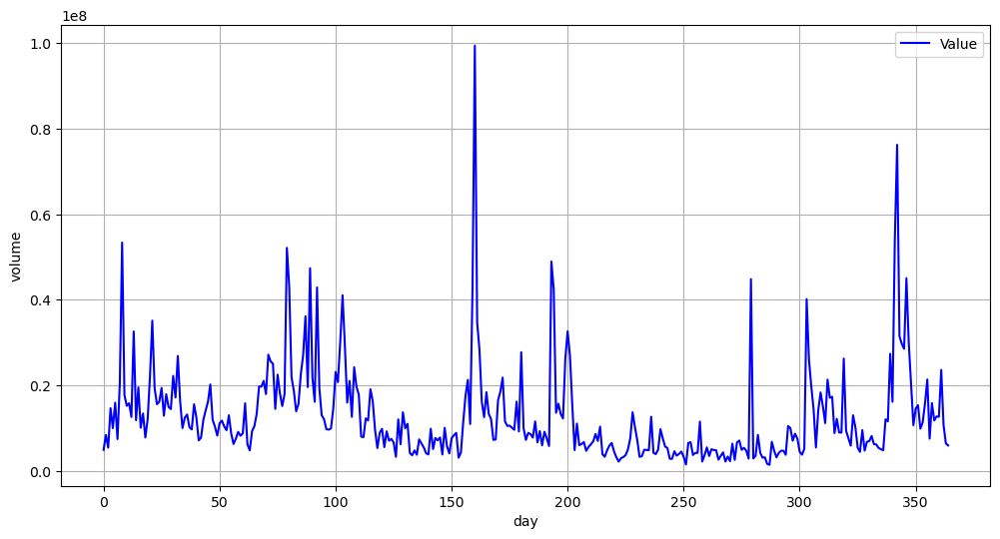

In [11]:

import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sample_volume))], sample_volume, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.xlabel("day")
plt.ylabel("volume")
plt.show()

## 対数階差をとる

In [12]:

import numpy as np

# 対数を取り、差分を計算
volume_log = list(np.log(sample_volume))

volume_log_diff = []

for i in range(len(volume_log)-1):
    volume_log_diff.append(volume_log[i+1] - volume_log[i])


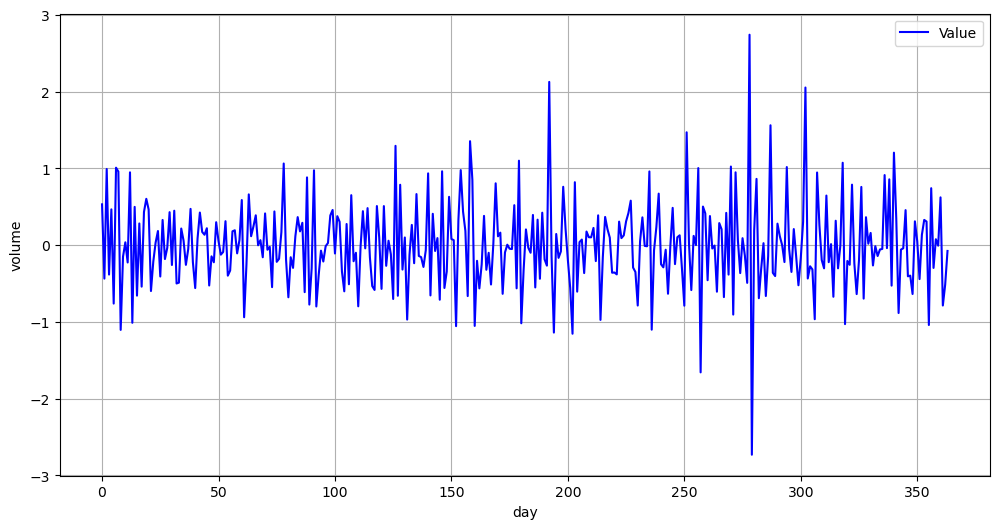

0.0005175233339820748


In [13]:

import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(volume_log_diff))], volume_log_diff, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.xlabel("day")
plt.ylabel("volume")
plt.show()

print(sum(volume_log_diff)/len(volume_log_diff))

## 定常性の検査(ADF検定)

In [14]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(volume_log_diff)

print("ADF Statistic:", end=" ")
print(result[0])

for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
print("p-value:", end=" ")
print(result[1])

ADF Statistic: -11.01888361978334
	1%: -3.449
	5%: -2.870
	10%: -2.571
p-value: 6.05807736739564e-20


## ARモデルの次数決定

In [15]:
from statsmodels.tsa.ar_model import AutoReg, ar_select_order

order = ar_select_order(volume_log_diff, maxlag=10, ic="aic")
best_order = order.ar_lags[-1]

model = AutoReg(volume_log_diff, lags=best_order)
model_fit = model.fit()

print(order.ar_lags)
print(best_order)
print(model_fit.summary())
print(model_fit.params)
print(model_fit.aic)

[1, 2, 3, 4, 5, 6]
6
                            AutoReg Model Results                             
Dep. Variable:                      y   No. Observations:                  364
Model:                     AutoReg(6)   Log Likelihood                -265.696
Method:               Conditional MLE   S.D. of innovations              0.508
Date:                Mon, 13 Jan 2025   AIC                            547.392
Time:                        17:57:43   BIC                            578.436
Sample:                             6   HQIC                           559.738
                                  364                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0006      0.027     -0.022      0.983      -0.053       0.052
y.L1          -0.4785      0.053     -9.091      0.000      -0.582      -0.375
y.L2          -0.3649      0.05

## モデルによる予測(やる必要はなさそう)

In [16]:
start = len(volume_log_diff)

end = start + 20

predictions = model_fit.predict(start=start, end=end)

print("prediction: ", predictions)

prediction:  [ 2.78646997e-01  1.06292764e-01  1.71221030e-02  3.37360141e-02
 -5.27604001e-02 -4.25249025e-02 -1.06414085e-02  1.43626221e-02
  1.21342282e-02  3.54853221e-03  1.98520378e-03 -3.73548074e-03
 -3.80389196e-03 -1.41728191e-03  4.65997923e-04  8.60083611e-04
  2.71450656e-04 -4.02897953e-05 -4.61279349e-04 -5.31038632e-04
 -3.59341815e-04]


/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 23455 (\N{CJK UNIFIED IDEOGRAPH-5B9F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12487 (\N{KATAKANA LETTER DE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12479 (\N{KATAKANA LETTER TA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20104 (\N{CJK UNIFIED IDEOGRAPH-4E88}) missing from 

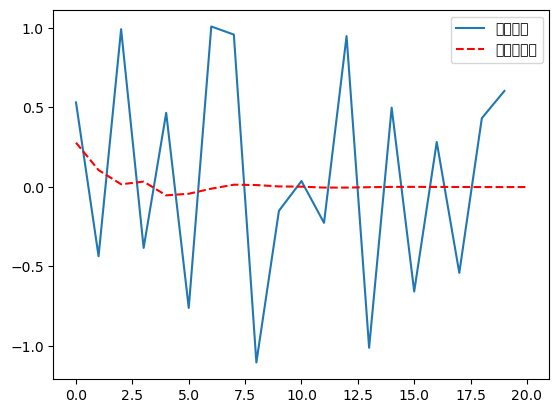

In [17]:
import matplotlib.pyplot as plt

# 実データと予測データをプロット
plt.plot(volume_log_diff[0:20], label="実データ")
plt.plot(predictions, label="予測データ", linestyle='--', color='red')
plt.legend()
plt.show()

## ARCHモデル実装

In [18]:
from arch import arch_model

model = arch_model(volume_log_diff, vol="ARCH", p=1)
model_fit = model.fit()

print("")
print(model_fit.params)

Iteration:      1,   Func. Count:      5,   Neg. LLF: 415966746888.68854
Iteration:      2,   Func. Count:     12,   Neg. LLF: 1436789.7827678593
Iteration:      3,   Func. Count:     18,   Neg. LLF: 350.67990936387923
Iteration:      4,   Func. Count:     24,   Neg. LLF: 302.3207448155299
Iteration:      5,   Func. Count:     29,   Neg. LLF: 302.2469834106348
Iteration:      6,   Func. Count:     32,   Neg. LLF: 302.2469834107045
Optimization terminated successfully    (Exit mode 0)
            Current function value: 302.2469834106348
            Iterations: 6
            Function evaluations: 32
            Gradient evaluations: 6

mu          0.018264
omega       0.256222
alpha[1]    0.205354
Name: params, dtype: float64


[0.25801727 0.309207   0.31971901 0.32187769 0.32232098 0.32241202
 0.32243071 0.32243455 0.32243534 0.3224355 ]


/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12514 (\N{KATAKANA LETTER MO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12487 (\N{KATAKANA LETTER DE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12523 (\N{KATAKANA LETTER RU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12395 (\N{HIRAGANA LETTER NI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 12424 (\N{HIRAGANA LETTER YO}) missing from current font.
  fig.canvas.print_fig

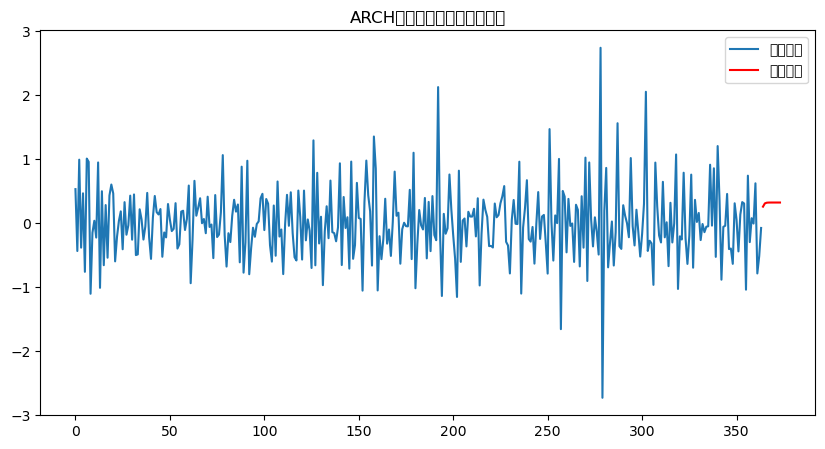

In [19]:
import matplotlib.pyplot as plt
import numpy as np
n_steps = 10
forecast = model_fit.forecast(horizon=n_steps)

print(forecast.variance.values[-1])

# 予測結果のプロット
plt.figure(figsize=(10, 5))
plt.plot([i for i in range(364)], volume_log_diff[-365:], label='実データ')
plt.plot(np.arange(len(volume_log_diff), len(volume_log_diff) + n_steps), forecast.variance.values[-1], label='予測分散', color='red')
plt.title('ARCHモデルによる分散の予測')
plt.legend()
plt.show()

## モデルを使った表示

In [20]:
import numpy as np
import copy

def model_value(const, a, omega, b, data, length):
    volatility = [np.random.normal(loc=0, scale=1)]
    return_value = copy.deepcopy(data)
    for i in range(length):
        x = 0
        for j in range(len(a)):
            x += const + a[j] * return_value[-j]
        x += (b * volatility[-1] + omega) * np.random.normal(loc=0, scale=1)
        return_value.append(x)
        print(x)
    return return_value
    


In [21]:
const = -0.00058574
a = [-0.47852162, -0.36493809 ,-0.24439078, -0.20961731, -0.12566232,
 -0.08781066]
omega = 0.256222
b = 0.205354
length = 300

ans = model_value(const=const, a=a, omega=omega, b=b, data=volume_log_diff, length=length)

0.01380465301976233
-0.11198355206212213
-0.009861766981586646
-0.10012870742254718
-0.1796277310727357
-0.19329445260972547
-0.15085397990192675
0.035470933900695445
-0.027677190174682176
-0.06642871011608135
-0.14085697518718449
-0.1339400641069739
-0.14981015828874336
-0.12881830256433385
-0.1033007535240164
-0.11222412406206903
-0.09215707062830045
-0.15906226708778975
-0.03537815847254941
-0.16673593766632788
-0.12808351192440226
-0.2599671360460309
-0.18362359458835126
-0.03625509073344542
-0.09511803770798581
-0.13831612576142116
-0.1858415021901303
-0.14504789441571922
-0.0777431486813967
-0.15897998816022516
-0.008228310930012223
-0.0971063454698525
-0.09604264218594036
-0.09277422717136666
-0.1476700608760006
-0.1369734944236788
-0.1891858641880032
-0.13581168232224738
-0.2309778016527624
-0.17813652330370033
-0.03693679616916345
-0.1395348408991317
-0.14464693651686786
-0.171434075164819
-0.0916928007070021
-0.08718298203072113
-0.20898364720239945
-0.2744759739683491
-0.049

In [22]:
ave = sum(ans[365:])/300
ave

-0.12492304190780473

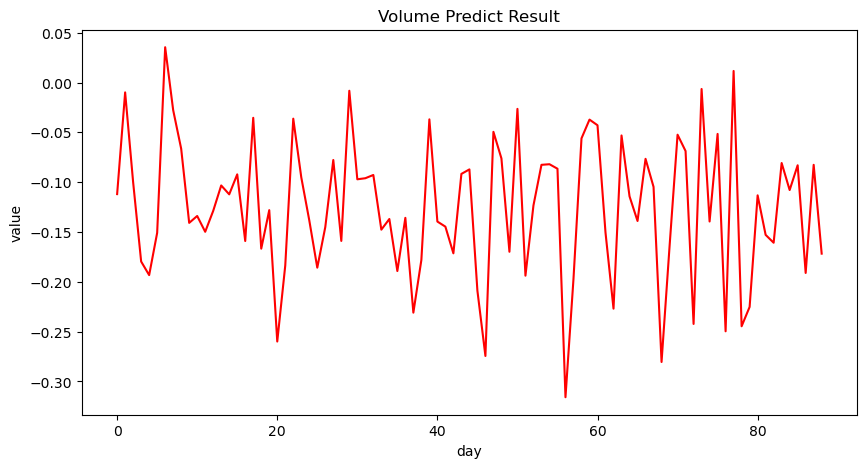

In [51]:
# 予測結果のプロット
plt.figure(figsize=(10, 5))
plt.plot([i for i in range(89)], ans[365:454], color='red')
plt.title('Volume Predict Result')
plt.xlabel("day")
plt.ylabel("value")
plt.show()

### 値の逆変換によって取引量のグラフ生成

In [24]:
import math

generated_volume = [sample_volume[364]]

for i in range(len(ans)-365):
    reversed_value = math.exp(ans[365+i]-ave) * generated_volume[i]
    generated_volume.append(reversed_value)


In [25]:
generated_volume

[5971761.3,
 6049534.9351471225,
 6787228.427584701,
 6957616.8442484,
 6587226.000240277,
 6151899.576837408,
 5994425.598222744,
 7037295.583000924,
 7756023.737865227,
 8223238.665838308,
 8093248.507112118,
 8020599.536586689,
 7823453.31832285,
 7793038.20426987,
 7963376.438547118,
 8065147.5253989585,
 8333787.000191999,
 8054079.631355428,
 8808556.978949029,
 8447839.576319378,
 8421182.57914232,
 7357396.789403137,
 6937944.994749045,
 7581215.716655496,
 7810574.930297096,
 7706664.638173608,
 7251200.429484559,
 7106729.692444282,
 7450059.898002128,
 7200605.546074904,
 8091870.025553987,
 8320118.965948333,
 8563910.785141874,
 8843703.775056003,
 8644806.612455,
 8541257.938105965,
 8009637.260437284,
 7922896.303022473,
 7125658.009188989,
 6756389.114350066,
 7377795.183849807,
 7270776.098389471,
 7128773.106534203,
 6804799.088330386,
 7034723.263859614,
 7305287.584648862,
 6716302.684252311,
 5783360.269506563,
 6236491.610402851,
 6548262.070870179,
 6260462.22864

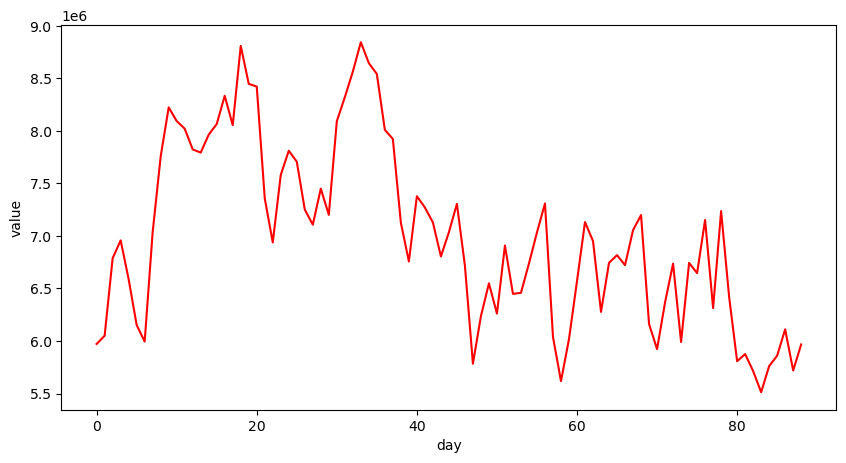

In [46]:
# 予測結果のプロット
plt.figure(figsize=(10, 5))
plt.plot([i for i in range(89)], generated_volume[:89], color='red')
plt.title('')
plt.xlabel("day")
plt.ylabel("value")
plt.show()

In [27]:
print(len(volume_log_diff))

364


## 価格の変動の影響も入れる

```math
y_{t} = y_{t-1} + y_{t-2} +  \cdots + y_{t-p} + \epsilon_{y} + \epsilon_{b}
```
εbについて推定を行う

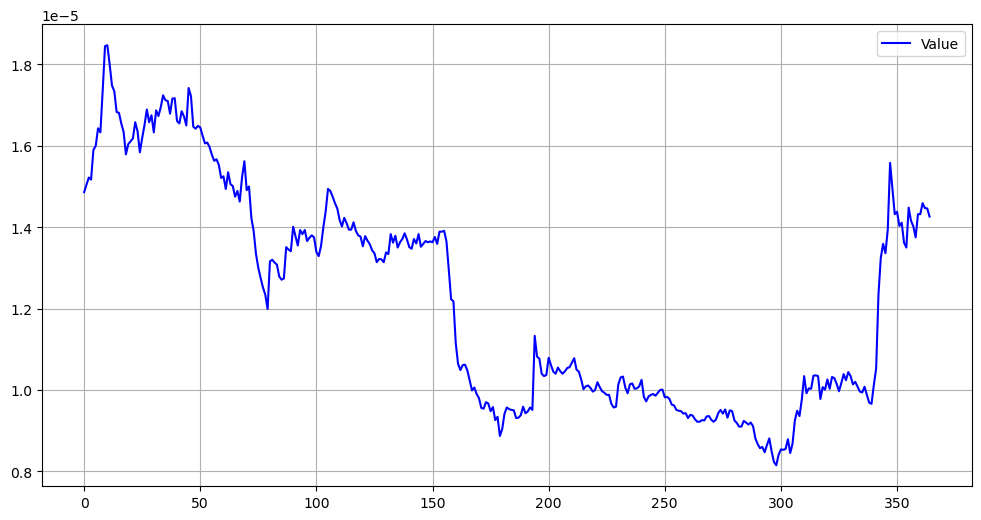

In [40]:
## 対数階差をとる

import numpy as np

import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sample_price))], sample_price, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.show()

### 対数階差をとる

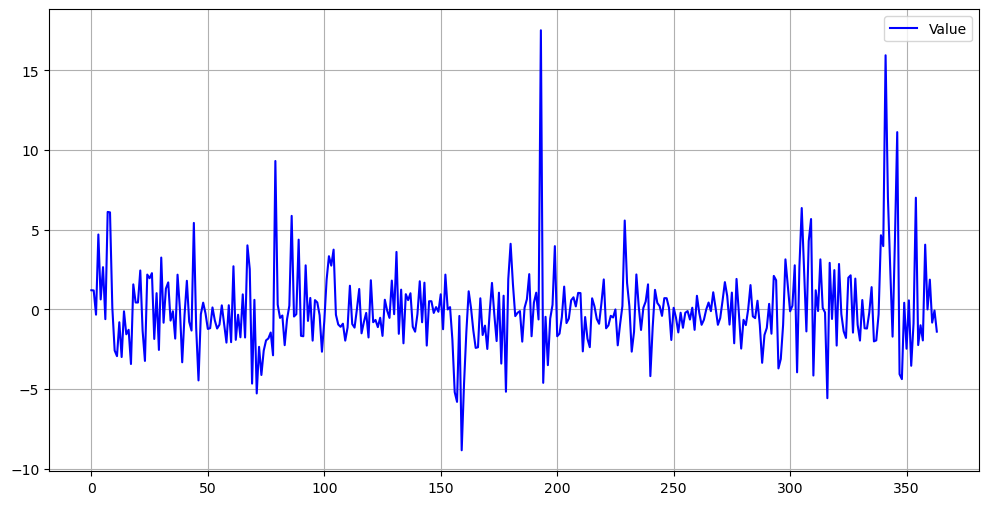

In [41]:
## 対数階差をとる

import numpy as np

# 対数を取り、差分を計算
price_log = list(np.log(sample_price))

price_log_diff = []

for i in range(len(price_log)-1):
    price_log_diff.append((price_log[i+1] - price_log[i])*100)


import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(price_log_diff))], price_log_diff, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.show()

↓必要なパラメータについて

https://statisticsschool.com/%E3%80%90%E3%83%A2%E3%83%87%E3%83%AB%E9%81%B8%E6%8A%9E%E3%80%91aic%E8%B5%A4%E6%B1%A0%E6%83%85%E5%A0%B1%E9%87%8F%E5%9F%BA%E6%BA%96%E3%81%AB%E3%81%A4%E3%81%84%E3%81%A6%E3%82%8F%E3%81%8B%E3%82%8A/

In [29]:
const = -0.0005857396922564296
a = [-0.47852162, -0.36493809, -0.24439078, -0.20961731, -0.12566232,-0.08781066]
omega = 0.25622218615769193
b = 0.20535376958752433
t = len(volume_log_diff)
p = 6

### AICを計算するための関数

In [30]:
import math

def aic(model_data, data, t, p):
    sum_value = 0
    for i in range(len(model_data)):
        sum_value += (model_data[i] - data[i+p]) ** 2
    return math.log(sum_value/t) + 2*(p+1)/t

In [31]:
import numpy as np
import math

def model_check(const, a, omega, b, p, test_param, volume_data, value_data):
    a.reverse()
    volatility = [np.random.normal(loc=0, scale=1)]
    generated_data_value = []
    for i in range(len(volume_data)-p):
        x = 0
        for j in range(p):
            x += volume_data[i+j] + a[j] + const
            if j == p-1:
                x += (value_data[i+j]) * test_param
        vol = b * volatility[-1] + omega * np.random.normal(loc=0, scale=1)
        x += vol
        volatility.append(vol)
        generated_data_value.append(x)
    return generated_data_value


### AIC基準によりパラメータ推定をする

In [32]:
check_data = []


for i in range(1, 2000):
    test_param = (i-1000)/1000
    param_return = model_check(const=const, a=a, omega=omega, b=b, p=p, test_param=test_param, volume_data=volume_log_diff, value_data=price_log_diff)
    target_value = aic(model_data=param_return, data=volume_log_diff, t=t, p=p)
    check_data.append(target_value)


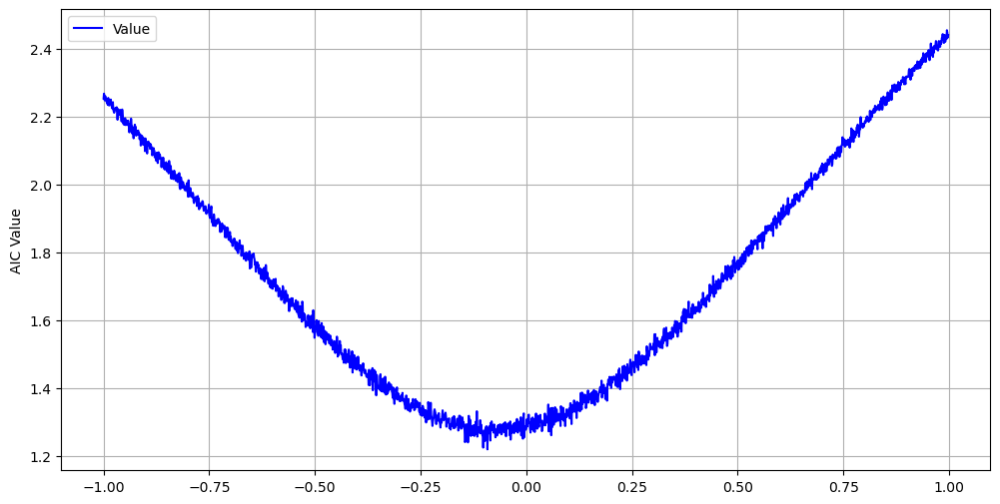

In [38]:
import matplotlib.pyplot as plt

x_first = -1
x_value = [-1]

for i in range(1998):
    x_first += 0.001
    x_value.append(x_first)

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot(x_value, check_data, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.ylabel("AIC Value")

plt.grid(True)
plt.show()


In [146]:
test_values = model_check(const=const, a=a, omega=omega, b=b, p=p, test_param=0.01, volume_data=volume_log_diff, value_data=price_log_diff)

In [147]:
len(test_values)

358

In [148]:
target_value = aic(model_data=test_values, data=volume_log_diff, t=t, p=p)

In [149]:
target_value

1.6653855746805684

## 価格についてのモデル作成

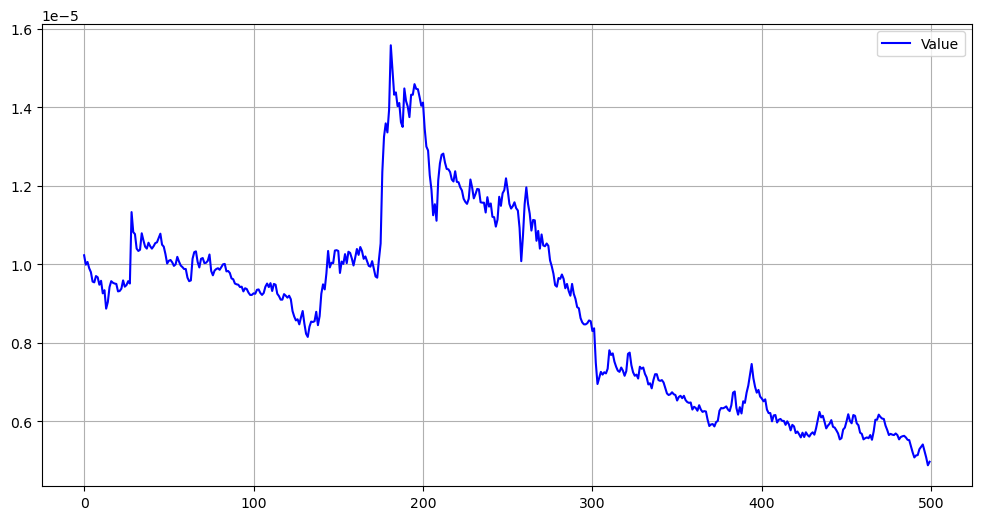

In [356]:

import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sample_price))], sample_price, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.show()

### 対数階差をとる

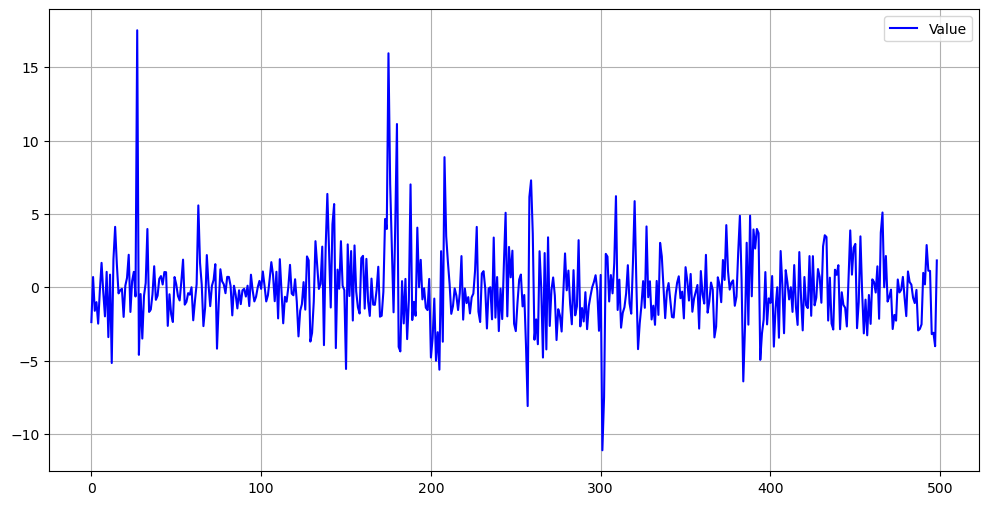

In [357]:
## 対数階差をとる

import numpy as np

# 対数を取り、差分を計算
price_log = list(np.log(sample_price))

price_log_diff = []

for i in range(len(price_log)-1):
    price_log_diff.append((price_log[i+1] - price_log[i])*100)


import matplotlib.pyplot as plt

# 時系列データのプロット
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(price_log_diff))], price_log_diff, label='Value', color='b')  # 'Value'はプロットしたいカラム名
plt.legend()
plt.grid(True)
plt.show()

In [358]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(price_log_diff)

print("ADF Statistic:", end=" ")
print(result[0])

for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
print("p-value:", end=" ")
print(result[1])

ADF Statistic: -20.560800959282172
	1%: -3.444
	5%: -2.867
	10%: -2.570
p-value: 0.0


In [359]:
from statsmodels.tsa.ar_model import AutoReg, ar_select_order

order = ar_select_order(price_log_diff, maxlag=20, ic="aic")
best_order = order.ar_lags[-1]

model = AutoReg(price_log_diff, lags=best_order)
model_fit = model.fit()

print(order.ar_lags)
print(best_order)
print(model_fit.summary())
print(model_fit.params)
print(model_fit.aic)

[1]
1
                            AutoReg Model Results                             
Dep. Variable:                      y   No. Observations:                  499
Model:                     AutoReg(1)   Log Likelihood               -1182.586
Method:               Conditional MLE   S.D. of innovations              2.601
Date:                Fri, 01 Nov 2024   AIC                           2371.171
Time:                        14:30:06   BIC                           2383.803
Sample:                             1   HQIC                          2376.129
                                  499                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1283      0.117     -1.099      0.272      -0.357       0.100
y.L1           0.0799      0.045      1.789      0.074      -0.008       0.167
                                    Roots     

In [360]:
from arch import arch_model

model = arch_model(price_log_diff, vol="ARCH", p=1)
model_fit = model.fit()

print("")
print(model_fit.params)

Iteration:      1,   Func. Count:      5,   Neg. LLF: 1954.9881799837694
Iteration:      2,   Func. Count:     11,   Neg. LLF: 1186.3911030503461
Iteration:      3,   Func. Count:     17,   Neg. LLF: 1169.0246879276533
Iteration:      4,   Func. Count:     22,   Neg. LLF: 1167.5607896921001
Iteration:      5,   Func. Count:     26,   Neg. LLF: 1167.5607843130033
Iteration:      6,   Func. Count:     29,   Neg. LLF: 1167.5607843130529
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1167.5607843130033
            Iterations: 6
            Function evaluations: 29
            Gradient evaluations: 6

mu         -0.282381
omega       4.978011
alpha[1]    0.298538
Name: params, dtype: float64


In [361]:
const = -0.1283
a = [0.0799]
omega = 4.978011
b = 0.298538
length = 300

ans = model_value(const=const, a=a, omega=omega, b=b, data=price_log_diff, length=length)

2.0783149203031255
-2.8812364155415295
1.2851877651200145
-2.6555797613545824
-4.202673902514032
1.4196889745948482
6.2991059101426305
12.21885128741588
-4.060214811269281
2.5649621699289935
-0.35059964310684555
1.437933838123469
-0.595262388757847
-4.5337017608377925
-4.085685665720489
5.659531200767188
-5.842353176529249
2.7001693448783533
-4.40773479679715
-1.6027327174129997
5.887306174974511
3.448807054873193
-2.5773083995185253
3.623765021389062
-1.7448809540577996
5.683861270991399
8.257188319887979
3.0561915185116093
-0.7303997617864644
-5.56494475853316
2.951577971999029
-1.3263997183205305
-1.6425327335542574
-11.312221236352789
4.747966331495719
1.075496339621901
1.0234317460996287
6.013521032526673
2.6787046935098604
0.40086850521637907
3.767531515454941
10.908859291379281
1.7726029308434361
3.2395530042998497
-2.193278068099934
-0.6173507111197638
-2.218744310898225
7.284785356905456
3.5305422319536994
7.903072715034464
-0.9552195682918011
-8.604837584045553
-2.20161750478

/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20104 (\N{CJK UNIFIED IDEOGRAPH-4E88}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 28204 (\N{CJK UNIFIED IDEOGRAPH-6E2C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/hiroki/anaconda3/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 25955 (\N{CJK UNIFIED IDEOGRAPH-6563}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


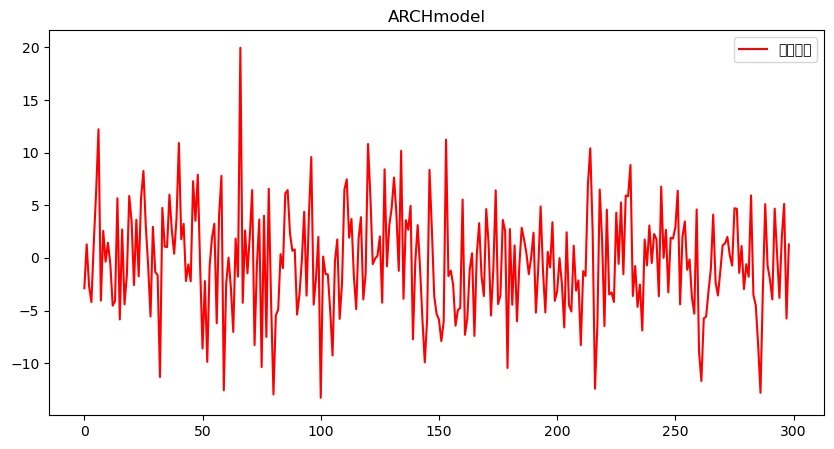

In [362]:
# 予測結果のプロット
plt.figure(figsize=(10, 5))
plt.plot([i for i in range(length-1)], ans[500:], label='予測分散', color='red')
plt.title('ARCHmodel')
plt.legend()
plt.show()

In [1]:

import json

with open("data/all_symbol_data.json") as f:
    datas = json.load(f)

datas

{'1000SATSFDUSD': {'price': [0.0002433,
   0.0005485,
   0.0005078,
   0.00075,
   0.0007278,
   0.0007743,
   0.0007352,
   0.0006806,
   0.0006925,
   0.0007063,
   0.00071,
   0.0006481,
   0.0006351,
   0.0006203,
   0.0008677,
   0.0008088,
   0.0008038,
   0.0007763,
   0.000798,
   0.0007861,
   0.0007827,
   0.0008148,
   0.0007814,
   0.0006779,
   0.000687,
   0.0006651,
   0.0006371,
   0.0006248,
   0.0006472,
   0.0005919,
   0.0006296,
   0.0006271,
   0.0005964,
   0.0006536,
   0.0006137,
   0.0006291,
   0.0006314,
   0.00061,
   0.0005651,
   0.000527,
   0.0005252,
   0.000525,
   0.0004895,
   0.0004387,
   0.0004312,
   0.0003853,
   0.0004963,
   0.000498,
   0.0004694,
   0.0005147,
   0.0005043,
   0.0005102,
   0.0004796,
   0.0004675,
   0.0004359,
   0.0004144,
   0.0004218,
   0.0004174,
   0.0004415,
   0.0004334,
   0.0004577,
   0.000447,
   0.0004283,
   0.0004693,
   0.0004538,
   0.0004718,
   0.0004717,
   0.0005227,
   0.0005111,
   0.0005317,
   0.0

In [5]:
datas["WAVES"]

KeyError: 'WAVES'